# Detección de plantas a partir de imágenes

### Integrantes



*   Javier de Jesús Silva (Ing. Sistemas e informática)
*   Santiago Salazar Ramirez (Ing. Sistemas e informática)
*   Jonathan Marcillo Pantoja (Ing. Agricola)
*   Juan José Garcia Marquez (Ing. Control) 
*   Alejandro Olivares Restrepo (Ing Mecanica)




### Descripción

<p>Actualmente existe una gran relevancia en el campo, dado que es uno de los sectores más relevantes en la economía nacional, como también es uno de los más preocupantes a la hora de hablar de modernización de métodos de producción y de distribución. Con esta problemática en mente se fundó la idea de realizar una identificación de plantas, esto como base para futuros análisis. </p>

<p>Las diferentes formas, colores y posiciones que pueden tomar las plantas es el principal problema de nuestra investigación, siendo poco uniforme la forma de identificar las diferentes plantas según la imagen en donde se tenga que identificar. Otro problema sería los factores ambientales que rodean a la planta, es decir, ¿en qué condiciones se encuentra el alrededor de la vegetación? Podría afectar la luminosidad que le llega a la planta, la humedad del ambiente, la cantidad de objetos diferentes dispersos cerca a la planta, etc. Con esto en mente formamos la pregunta de esta investigación: ¿qué es lo esencial de una planta para identificar lo que es la planta? </p>

<p>Es importante clasificar las plantas, debido a que de esta manera comprendemos su funcionalidad, sus cualidades, características y podemos comprender el comportamiento natural, así como utilizar a favor las propiedades de la misma.

Las plantas tienen muchas cualidades importantes, algunas medicinales, otras generadores y otras consumibles. El clarificarlas nos permite entender cómo se comportan las plantas y cómo pueden ser útiles. </p>

<p>A raíz de esto nace la idea de seleccionar y clasificar las plantas de manera automatizada con el uso de visión artificial en el proceso, esto es un componente importante por la gran variedad de utilidades que posee, por ejemplo, la deteccion de objetos y la evaluación de resultados. </p>

### ¿Cómo vamos a resolver esto?

¿Por qué? : Hoy en día algunas empresas utilizan materiales que son nocivos para la salud del trabajador "fungicidas", lo cual genera ambientes hostiles que imposibilitan el desempeño ideal. Además del ambiente, el factor humano afecta el proceso de revisión, los cuales pueden ser ocasionados por el mismo estado anímico o cansancio físico del colaborardor, surgiendo entonces esta alternativa: el uso de algoritmos de supervisión para seleccionarlas y clasificarlas.

¿Cómo? : Para la toma de imágenes de las plantas es necesario un espacio de trabajo  en donde la interferencia sea mínima, garantizando así gran detalle en toda el área de la hoja, y poder hacer una buena clasificación de la misma.  Luego se procede a convertir las imágenes a diferentes espacios de color y analizar la información que se puede obtener de la imagen a partir de cada uno de los canales analizados, para lo cual, se procede a analizar también su respectivo histograma y poder realizar un mejor análisis.


¿para que?: Se implementara un sistema de reconocimiento con vision artificial para la seleccion de hojas de plantas, identificando criterios de selccion para cada una, de acuerdo a los parametros establecidos por un experto.

<p> </p>

### Dataset

<p>Lo más importante por anunciar: las imagenes usadas en este trabajo NO son de nuestra creación, son suministradas gracias a Minervini, Scharr y Tsaftaris; es gracias a ellos que el siguiente análisis fue posible. La composición de las plantas se basa de una variedad de pequeñas plantas con una diferente cantidad distinta de hojas, donde cada planta es diferente en cuanto a las formas de sus hojas y su cantidad, pero su base no difiere entre ellas. <br> La cantidad de imagenes suministradas por Minervini son más de 500, pero se usaron 5 para la caracterización de las imagenes. El mayor limitante a la hora de realizar todo el proceso es distinguir la planta de su contorno, puesto sus colores son similares entre sí.  </p>

In [11]:
%matplotlib inline
import cv2
import matplotlib.pyplot as plt
import numpy as np

## Análisis canales RGB

<p> El proceso consiste en leer las imagenes, para luego por cada imagen mostrar 3 imagenes según el canal correspondiente (RGB). Este proceso se realizó con el objetivo de identificar en qué canal la planta se distingue del ambiente. Cabe aclarar que se aplicó una corección de gama, para poder aplicar en condiciones similares las plantas (la última planta empleada tiene una diferencia en su iluminación) <p>

In [3]:
# Funciones para aplicar cambio en luz
#Definir la función para aplicar la transformación sobre la imagen RGB
def apply_f_on_rgb(img, f, args):
    
    #Crear una matriz de ceros del tamaño de la imagen de entrada
    res = np.zeros(img.shape, np.uint8)
    #Aplicar la transformación f sobre cada canal del espacio de color RGB
    res[:,:,0] = f(img[:,:,0], *args)
    res[:,:,1] = f(img[:,:,1], *args)
    res[:,:,2] = f(img[:,:,2], *args)
    
    return res

#Definir la función de transformación de la imagen (corrección gamma)
def gamma_correction(img, a, gamma):
    
    #Crear copia de la imagen tipo flotante dada la normalización
    img_copy = img.copy().astype(np.float32)/255.0
    #La función corrección gamma es de la forma ax^gamma, donde x es la imagen de entrada
    res_gamma = cv2.pow(img_copy,gamma)
    res = cv2.multiply(res_gamma, a)
    
    #Asegurar que la los datos queden entre 0 y 255 y sean uint8
    res[res<0] = 0
    res = res*255.0
    res[res>255] = 255
    
    res = res.astype(np.uint8)
    
    return res

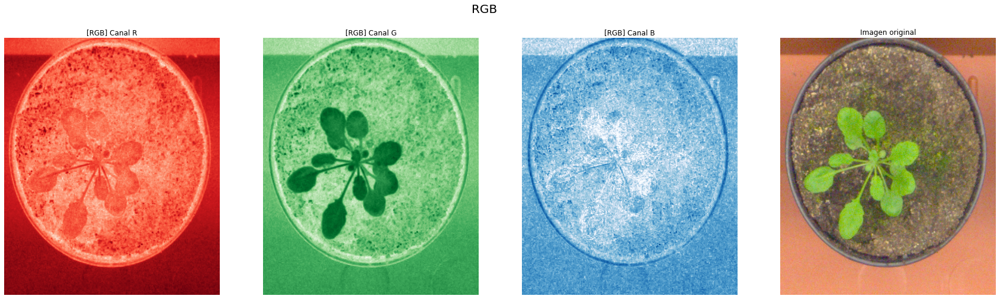

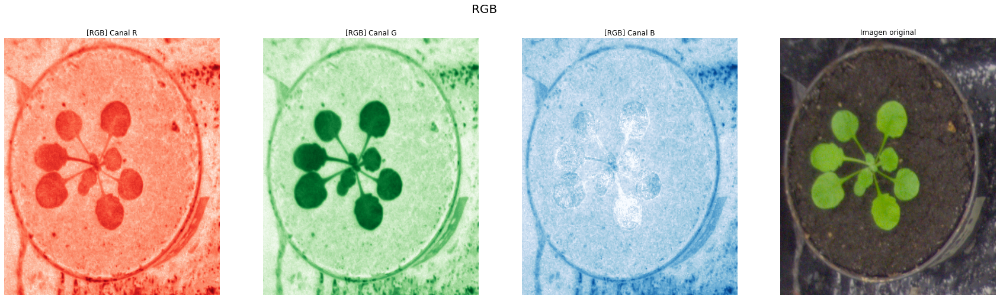

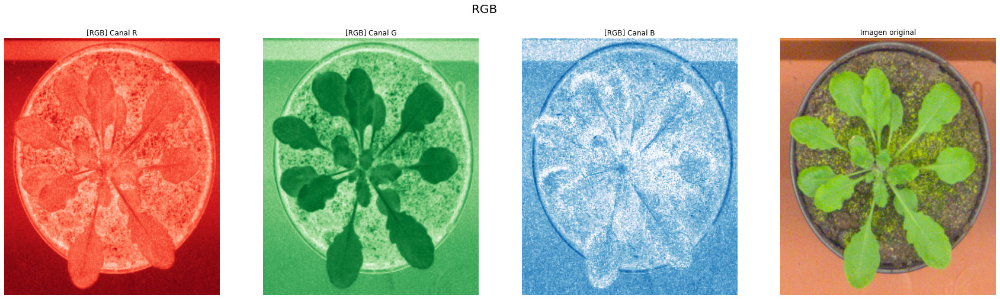

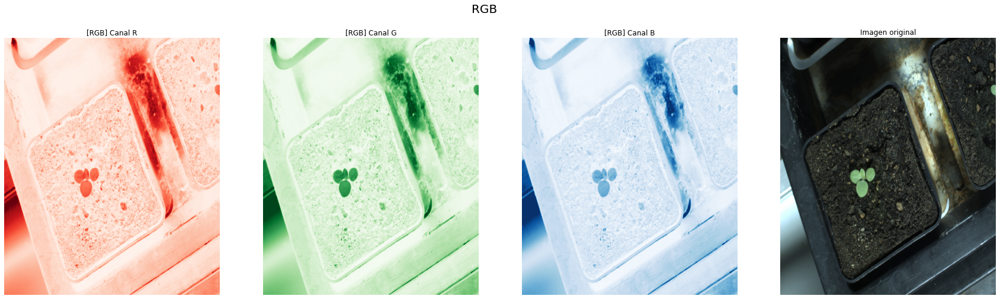

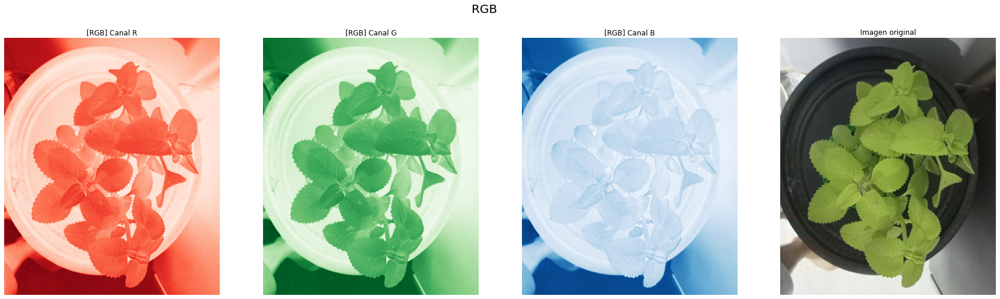

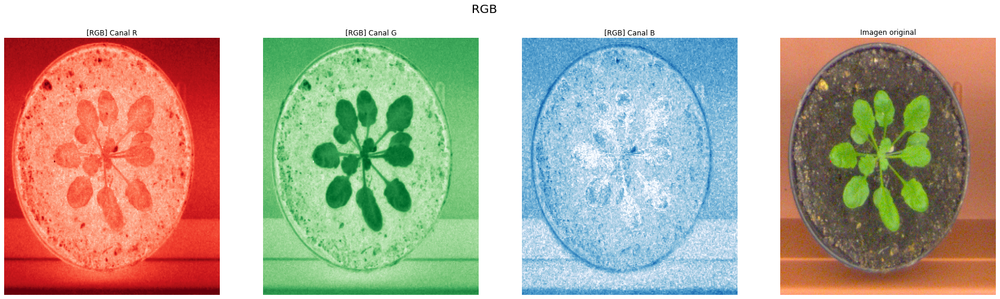

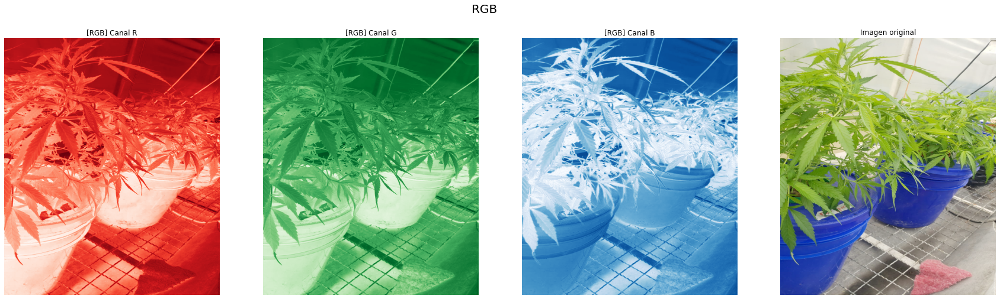

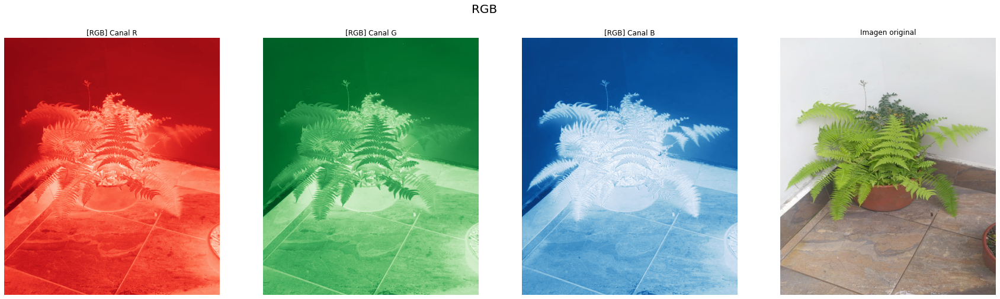

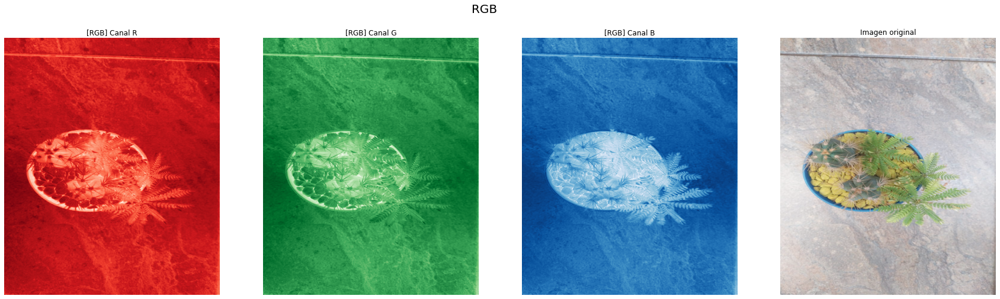

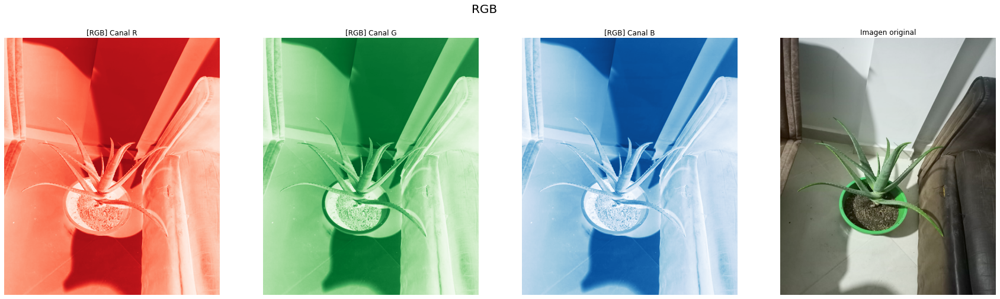

In [4]:
#Canal RGB
# Paths de las diferentes imagenes
img_path = ["res/img1.png", "res/img2.png", "res/img3.png", "res/img4.png","res/img6.jpg","res/img5.png","res/img7.jpg","res/img8.jpg","res/img9.jpg","res/img10.jpg"]

# Se hace una lista para ir agregando las diferentes imagenes ya leídas, no solo el path.
loaded_img = []
# El brillo aumentado, para usar las listas a las que se les va a aplicar la función de gamma
brillo_aumentado = []

for p in img_path:
  loaded_img.append(cv2.imread(p, cv2.IMREAD_COLOR))
# Se carga cada imagen y se le aplica la función
for img in loaded_img:
    #Dar valor a los parámetros a,gamma (args)
  a = 1
  gamma = 0.75
  # cv2.cvtColor(img, cv2.COLOR_BGR2XYZ)
  #Aplicar la transformación corrección gamma sobre la imagen de entrada
  b = apply_f_on_rgb(cv2.cvtColor(img, cv2.COLOR_BGR2RGB), gamma_correction, [a, gamma])
  brillo_aumentado.append(b)

# Se hace un for por cada imagen y se crean 3 imagenes en sus tres distintos canales con la función de brillo
for img_rgb in brillo_aumentado:
    img_R, img_G, img_B = img_rgb[:,:,0], img_rgb[:,:,1], img_rgb[:,:,2]
    # El subplot es para agregar las 4 imagenes: 3 de los distintos canales y la imagen original
    fig, (ax1, ax2, ax3, ax4) = plt.subplots(1,4, figsize=(30, 8))
    # Se desactiva el axis, dado que no es necesario verlo como si se tratase de un plano cartesiano.
    ax1.axis("off")
    ax2.axis("off")
    ax3.axis("off") 
    ax4.axis("off") 
    # Los subtitulos para que se pueda notar cual es cada imagen
    fig.suptitle('RGB', fontsize=20)
    ax1.set_title('[RGB] Canal R')
    ax1.imshow(img_R, cmap='Reds', aspect='auto')
    ax2.set_title('[RGB] Canal G')
    ax2.imshow(img_G, cmap='Greens', aspect='auto')
    ax3.set_title('[RGB] Canal B')
    ax3.imshow(img_B, "Blues", aspect='auto')
    ax4.set_title('Imagen original')
    ax4.imshow(img_rgb, aspect='auto')

## Análisis canales LAB

<p> Como ya se tienen las imagenes no es necesario volver a tomar del path, sino que meramente se hace un análisis de los canales posibles con LAB, para luego elegir cual es el mejor canal para la distinción de la planta en la imagen. </p>

In [ ]:
 #Canal LAB

channel_A_imgs = []
# Un for en todas las imagenes de brillo aumentado
for img in brillo_aumentado:
    #img = img[140:140 + 20, 120:120 + 20]
    # Se pasa a tipo img_lab
    img_lab  = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    img_L, img_A, img_B = img_lab[:,:,0], img_lab[:,:,1], img_lab[:,:,2]

    """
    flata = img_A.ravel()
    avg = 0
    for n in flata:
      avg+=n;

    avg = avg/len(flata)
    print(avg)

    """
    # Se agregan a esta lista porque se decidió más tarde que este es el mejor canal para hacer el análisis posterior 
    channel_A_imgs.append(img_A)
    fig, ((ax1, ax2, ax3, ax4), (his1, his2, his3, his4)) = plt.subplots(2,4, figsize=(25, 15))
    ax1.axis("off")
    ax2.axis("off")
    ax3.axis("off")
    ax4.axis("off")

    #Canales
    fig.suptitle('Canal LAB', fontsize=20)
    ax1.set_title('[LAB] Canal Luminosidad')
    ax1.imshow(img_L, aspect='auto')
    ax2.set_title('[LAB] Canal A*')
    ax2.imshow(img_A, aspect='auto')
    ax3.set_title('[LAB] Canal B*')
    ax3.imshow(img_B, aspect='auto')
    ax4.set_title('Formato original')
    ax4.imshow(img_lab, aspect='auto')

    # Histogramas
    his1.set_title('[LAB] Histograma canal luminosidad')
    hisdata = img_L.ravel()
    his1.hist(hisdata,histtype='step', bins=255, range=(0.0, 255.0),density=True)
    his2.set_title('[LAB] Histograma canal A*')
    hisdata = img_A.ravel()
    his2.hist(hisdata,histtype='step', bins=255, range=(0.0, 255.0),density=True)
    his3.set_title('[LAB] Histograma canal B*')
    hisdata = img_B.ravel()
    his3.hist(hisdata,histtype='step', bins=255, range=(0.0, 255.0),density=True)
    his4.set_title('Formato original')
    hisdata = img_lab.ravel()
    his4.hist(hisdata,histtype='step', bins=255, range=(0.0, 255.0),density=True)

## Análisis canales XYZ

In [ ]:
  #Canal XYZ
# For en las imagenes
for img in brillo_aumentado:
    # Pasar a XYZ
    img_xyz  = cv2.cvtColor(img, cv2.COLOR_BGR2XYZ)
    img_X, img_Y, img_Z = img_xyz[:,:,0], img_xyz[:,:,1], img_xyz[:,:,2]
    fig, (ax1, ax2, ax3, ax4) = plt.subplots(1,4, figsize=(30, 8))
    ax1.axis("off")
    ax2.axis("off")
    ax3.axis("off") 
    ax4.axis("off") 
    fig.suptitle('Canal XYZ', fontsize=20)
    ax1.set_title('Canal X')
    # Se usa gray para una mejor visualización
    ax1.imshow(img_X, cmap = "gray", aspect='auto')
    ax2.set_title('Canal Y')
    ax2.imshow(img_Y, cmap = "gray", aspect='auto')
    ax3.set_title('Canal Z')
    ax3.imshow(img_Z, cmap = "gray", aspect='auto')
    ax4.set_title('Formato original')
    ax4.imshow(img_xyz,  aspect='auto')

## Aislamiento de la planta

<p>Wa </p>

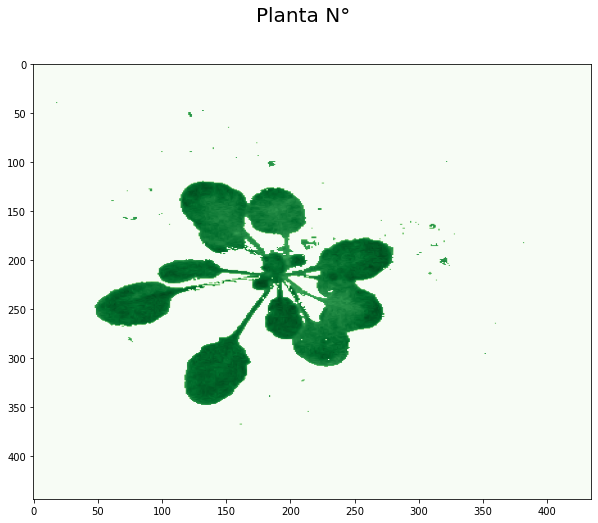

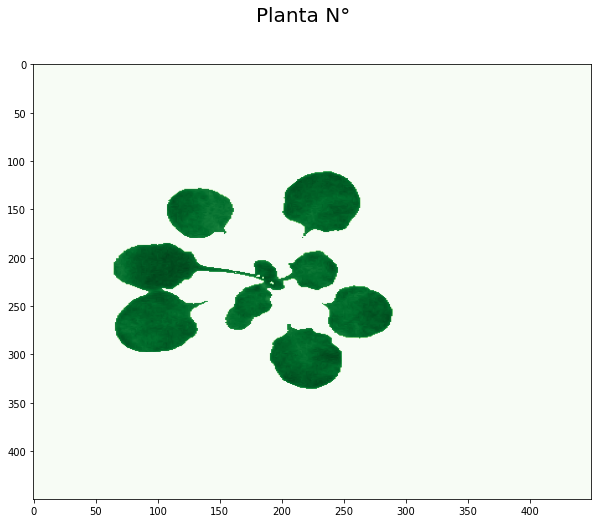

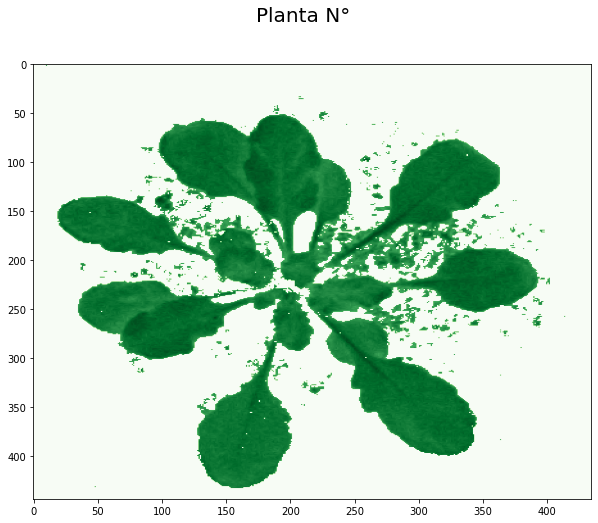

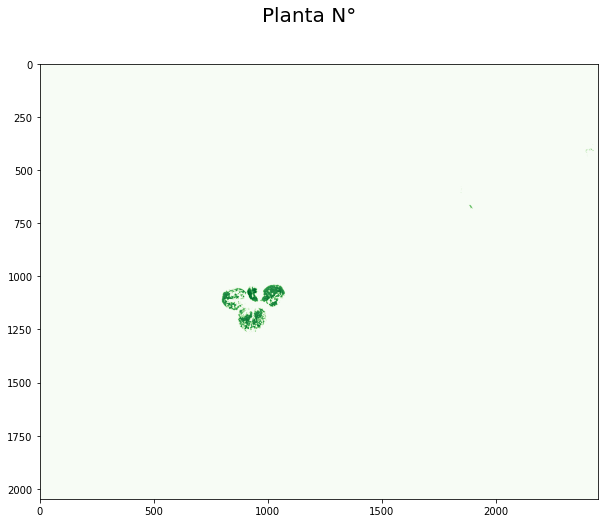

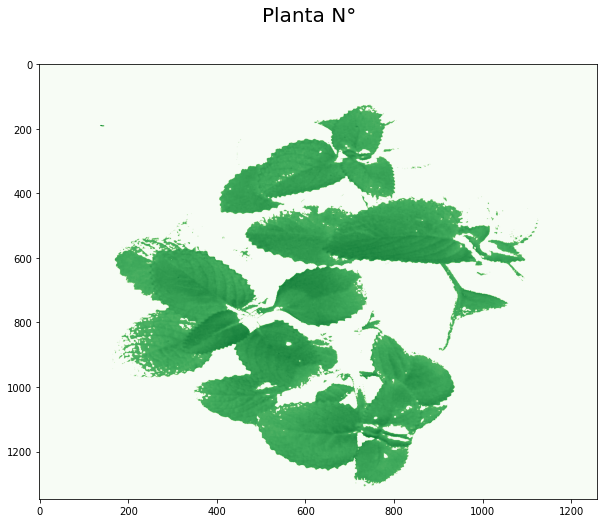

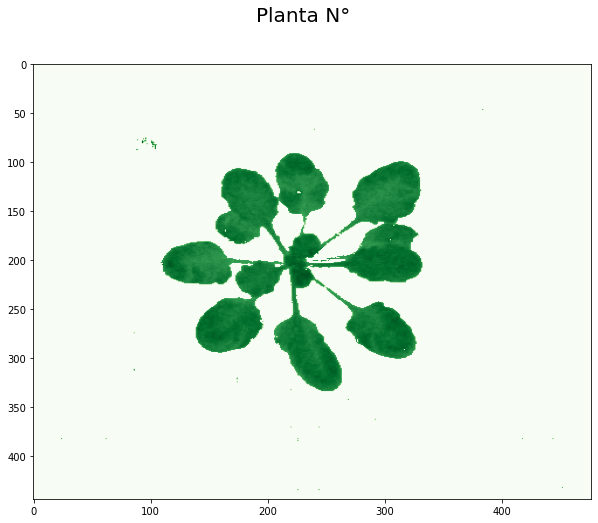

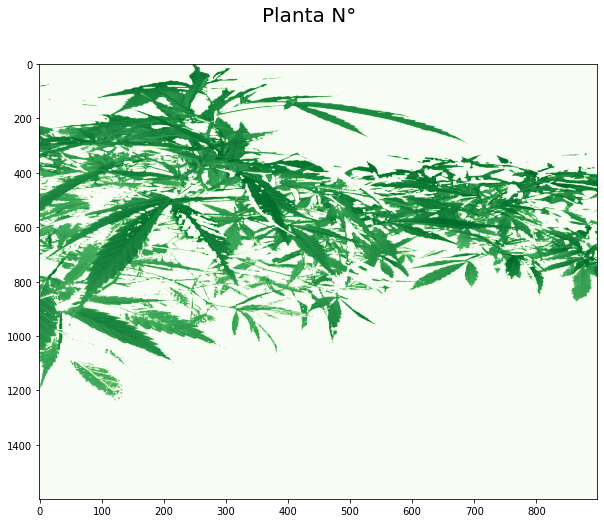

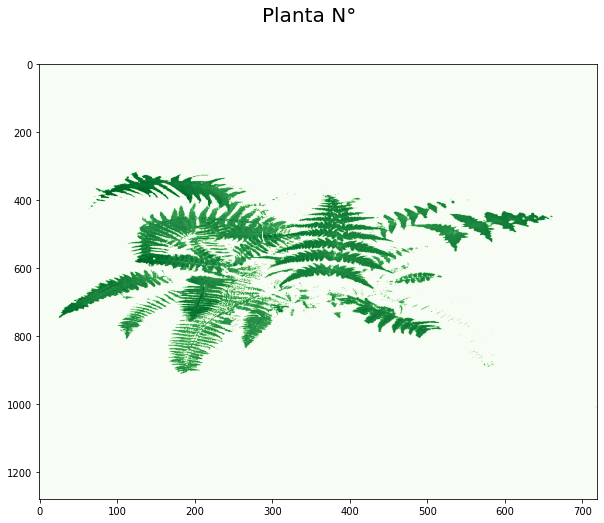

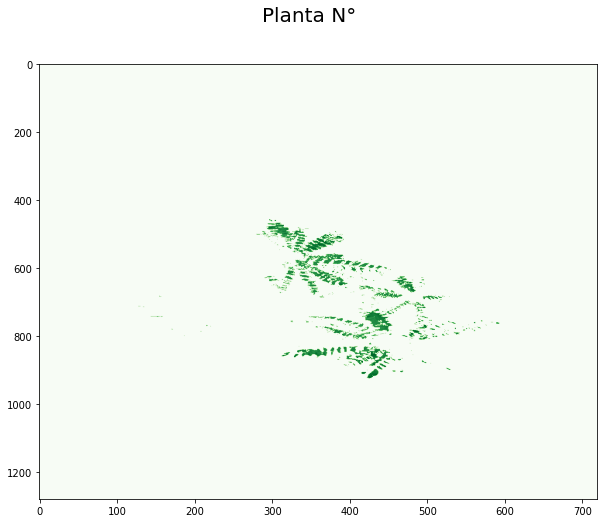

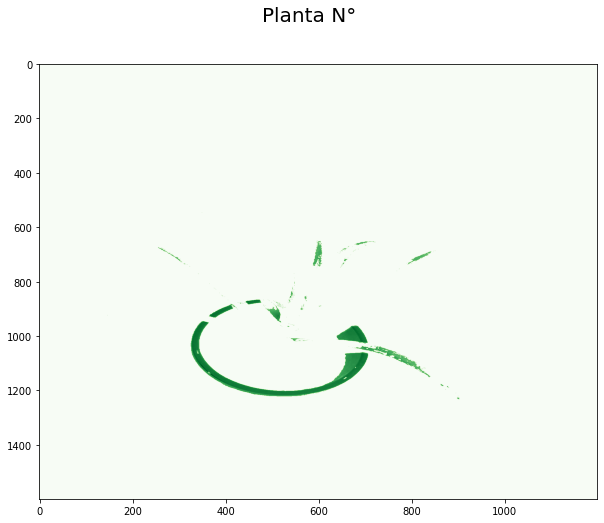

In [5]:
adjusted_green_channels = []

for img_rgb in brillo_aumentado:
  rc, gc, bc = img_rgb[:, :, 0], img_rgb[:, :, 1], img_rgb[:, :, 2]
  new_gc = gc.copy()

  for r in range(gc.shape[0]):
    for c in range(gc.shape[1]):
      if int(gc[r][c]) > 0.6*int(rc[r][c]) + 0.82*int(bc[r][c]) and int(gc[r][c]) > 140:
        new_gc[r][c] = gc[r][c]
      else:
        new_gc[r][c] = 0

  adjusted_green_channels.append(new_gc)

  fig, ax1 = plt.subplots(1,1, figsize=(10, 8))

  fig.suptitle("Planta N°", fontsize = 20)
  ax1.imshow(new_gc, "Greens", aspect = "auto")



In [6]:
for i in range(len(adjusted_green_channels)):
    adjusted_green_channels[i][adjusted_green_channels[i] > 0] = 1


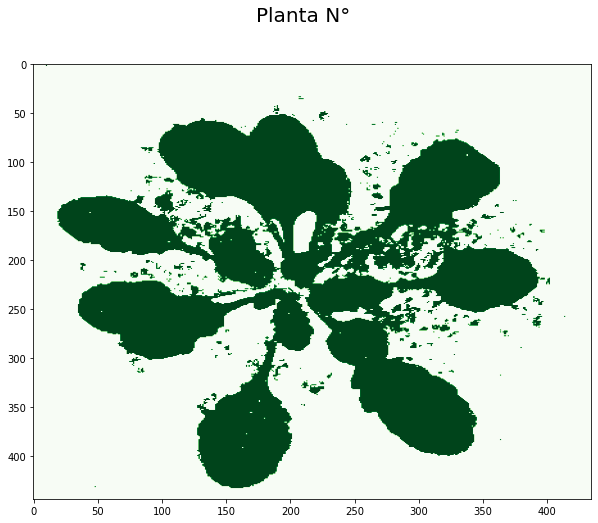

In [46]:
fig, ax1 = plt.subplots(1,1, figsize=(10, 8))

fig.suptitle("Planta N°", fontsize = 20)
ax1.imshow(adjusted_green_channels[2], "Greens", aspect = "auto")

In [8]:

clean_green = []
threshold_const = 0.15# Bajo este
for adj in adjusted_green_channels:
  cln = adj.copy()
  sqr_size = 5 # Si bajo este

  for r in range(adj.shape[0]):
    for c in range(adj.shape[1]):
      ofl = c - sqr_size
      ofr = c + sqr_size

      oft = r - sqr_size
      ofb = r + sqr_size

      sqrs = []

      if 0 <= ofr < adj.shape[1] and 0 <= ofb < adj.shape[0]: # Si el cuadrado de abajo a la derecha existe.
        bottom_right = adj[r:ofb, c:ofr]
        sqrs.append(bottom_right)
      
      if 0 <= ofr < adj.shape[1] and 0 <= oft < adj.shape[0]:
        top_right = adj[r:oft, c:ofr]
        sqrs.append(top_right)
      
      if 0 <= ofl < adj.shape[1] and 0 <= ofb < adj.shape[0]:
        bottom_left = adj[r:ofb, c:ofl]
        sqrs.append(bottom_left)

      if 0 <= ofl < adj.shape[1] and 0 <= oft < adj.shape[0]:
        top_left = adj[r:oft, c:ofl]
        sqrs.append(top_left)

      sqavg = 0
      for s in sqrs:
        sf = s.ravel()
        st = sum(sf)/(sqr_size*sqr_size)
        sqavg += st

      sqavg = sqavg/len(sqrs)

      if sqavg < threshold_const:
        cln[r][c] = 0

  clean_green.append(cln)

KeyboardInterrupt: 

In [9]:
clean_green = []
threshold_const = 0.15# Bajo este
adj = adjusted_green_channels[0]
cln = adj.copy()
sqr_size = 5 # Si bajo este

for r in range(adj.shape[0]):
  for c in range(adj.shape[1]):
    ofl = c - sqr_size
    ofr = c + sqr_size

    oft = r - sqr_size
    ofb = r + sqr_size

    sqrs = []

    if 0 <= ofr < adj.shape[1] and 0 <= ofb < adj.shape[0]: # Si el cuadrado de abajo a la derecha existe.
      bottom_right = adj[r:ofb, c:ofr]
      sqrs.append(bottom_right)
    
    if 0 <= ofr < adj.shape[1] and 0 <= oft < adj.shape[0]:
      top_right = adj[r:oft, c:ofr]
      sqrs.append(top_right)
    
    if 0 <= ofl < adj.shape[1] and 0 <= ofb < adj.shape[0]:
      bottom_left = adj[r:ofb, c:ofl]
      sqrs.append(bottom_left)

    if 0 <= ofl < adj.shape[1] and 0 <= oft < adj.shape[0]:
      top_left = adj[r:oft, c:ofl]
      sqrs.append(top_left)

    sqavg = 0
    for s in sqrs:
      sf = s.ravel()
      st = sum(sf)/(sqr_size*sqr_size)
      sqavg += st

    sqavg = sqavg/len(sqrs)

    if sqavg < threshold_const:
      cln[r][c] = 0

clean_green.append(cln)

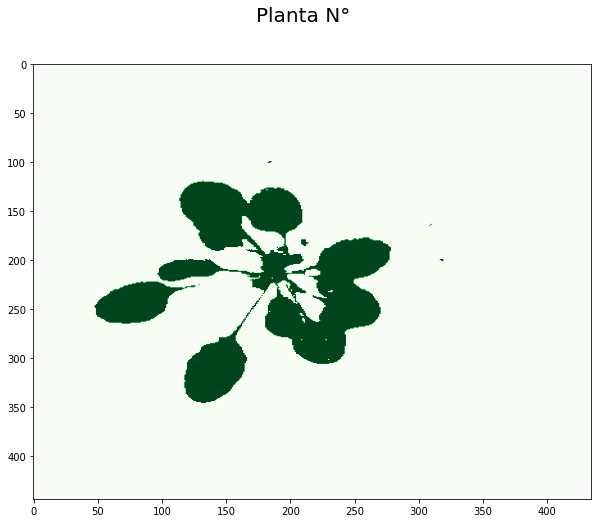

In [10]:
for clean in clean_green:
  fig, ax1 = plt.subplots(1,1, figsize=(10, 8))

  fig.suptitle("Planta N°", fontsize = 20)
  ax1.imshow(clean, "Greens", aspect = "auto")


## Detección de las plantas

<p>Se busca el pixel negro que esté más arriba, más a la izquierda, más a la derecha y más abajo. Luego de detectar estos pixeles se dibuja un recuadro rojo alrededor de la imagen original. </p>

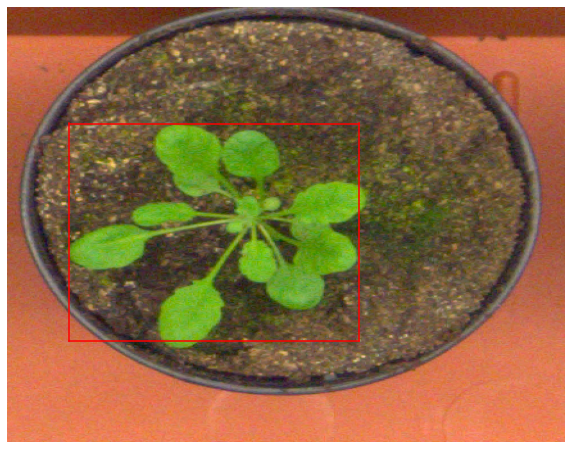

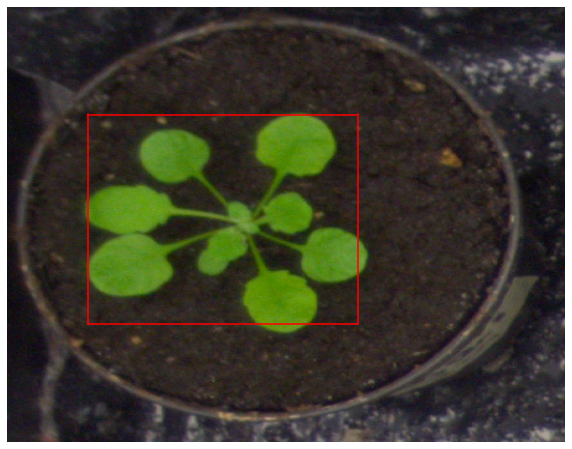

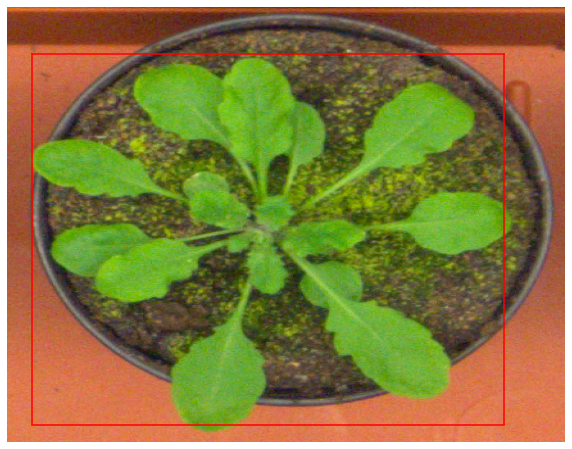

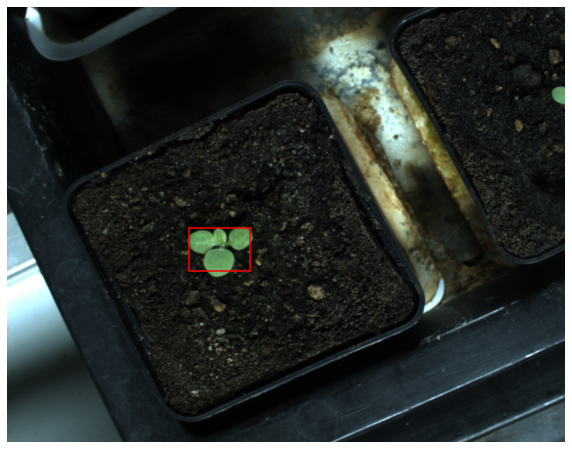

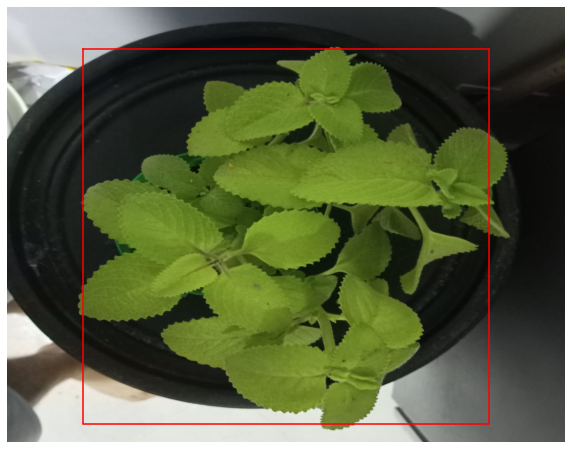

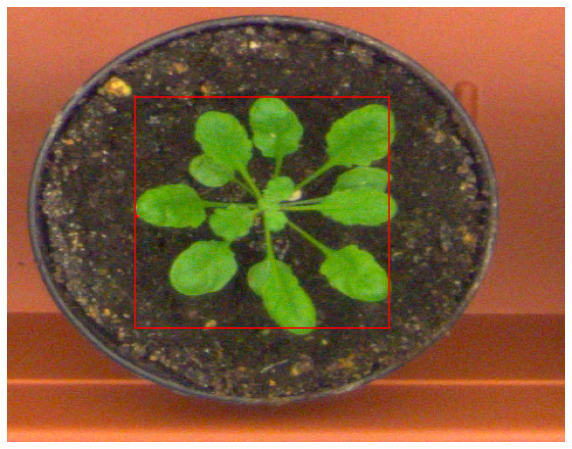

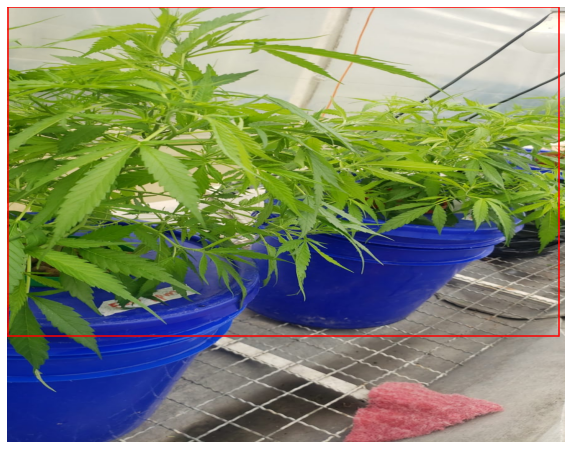

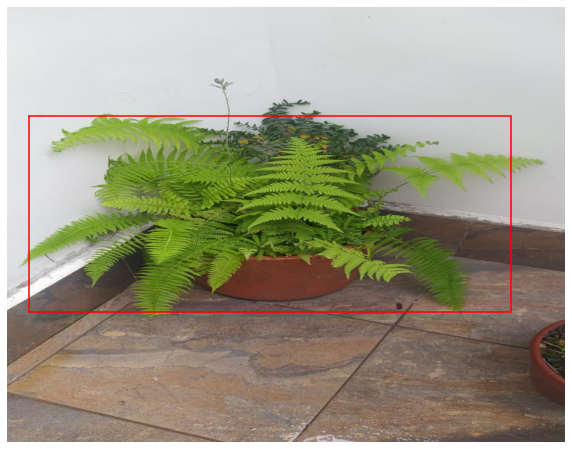

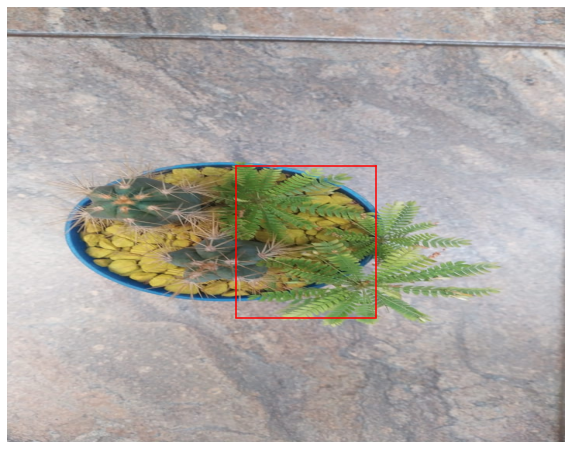

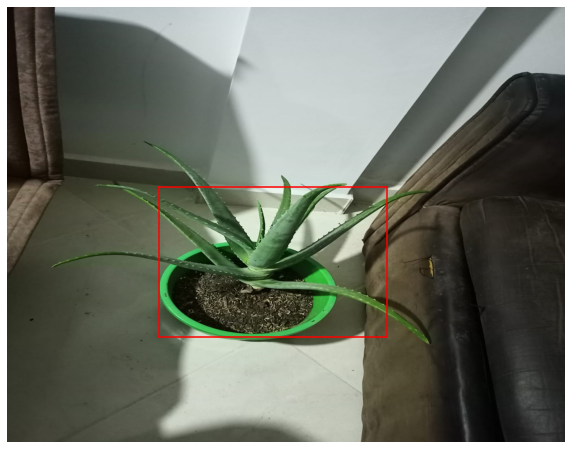

In [ ]:
indm = 0
for tr in clean_green:
  
    fig, ax1 = plt.subplots(1,1, figsize=(10, 8))
    ax1.axis("off")

    #tr = threshold[1]
    ax1.imshow(cv2.cvtColor(loaded_img[indm], cv2.COLOR_BGR2RGB), aspect = "auto")
    # Definición de los pixeles
    px_leftmost = tr.shape[0]
    px_rightmost = 0
    py_topmost = 0
    tmf = False
    py_bottommost = 0
    # Encontrar cada pixel (Más a la izquierda, más a la derecha, más arriba y más abajo)
    indy = 0
    for f in tr:
      indx = 0
      if any(i > 0 for i in f) and tmf == False:
        py_topmost = indy
        tmf = True

      if any(i > 0 for i in f):
        py_bottommost = indy

      indy += 1
      for c in f:
        if c > 0 and indx < px_leftmost:
          px_leftmost = indx

        if c > 0 and indx > px_rightmost:
          px_rightmost = indx

        indx += 1
    # Dibujo de las líneas
    ax1.axhline(py_topmost, px_leftmost/tr.shape[1], px_rightmost/tr.shape[1], c = "red")
    ax1.axhline(py_bottommost, px_leftmost/tr.shape[1], px_rightmost/tr.shape[1], c = "red")
    ax1.axvline(px_leftmost, (tr.shape[0] - py_bottommost)/tr.shape[0], (tr.shape[0] - py_topmost)/tr.shape[0], c = "red")
    ax1.axvline(px_rightmost, (tr.shape[0] - py_bottommost)/tr.shape[0], (tr.shape[0] - py_topmost)/tr.shape[0], c = "red")

    """
    print(px_leftmost)
    print(px_rightmost)
    print(py_topmost)
    print(py_bottommost)
    """
    # Se usa indm para iterar por cada imagen original
    indm+=1
    #print(tr.shape)
    #img = img[140:140 + 20, 120:120 + 20]

# Conclusiones y resultados

Se realizo la descomposicion de las imagenes del dataset en canales RGB,XYZ y LAB donde se observo que en las descomposiociones XYZ y LAB no se observaron grandes diferencias que permitieran segmentar las imagenes, tambien se concluyo que por las condicones cromaticas del objeto de estudio , lo mas apropiado para segmentar las imagenes es el canal RGB , en especial el canal G , es aque que mayor  resalta las caracterisitcas de los objetos de estudio.
